In [1]:
import os
from pathlib import Path
from PIL import Image, ImageOps
from sklearn.model_selection import train_test_split

In [13]:
images_folder = '../task/train_dataset/'
masks_folder = '../task/train_dataset_masks/'

files = sorted([x.name for x in Path('../datasets/0-last-broken/last_viewer_broken_images').glob('*.png')], key=lambda x: int(x.split('.')[0]))

In [6]:
def imread(folder, name):
    return Image.open(f"{folder}/{name}")

def overlay(image, mask):
    return Image.composite(image, Image.new('RGB', image.size, (255,0,0)), ImageOps.invert(mask.convert('L')))

In [7]:
seed = 1024
train_indices, val_indices = train_test_split(files, test_size=.2, random_state=seed)

In [14]:
import shutil

target_folder = '../datasets/0-last-broken/train'
os.makedirs(f"{target_folder}/images", exist_ok=True)
os.makedirs(f"{target_folder}/masks", exist_ok=True)
for a in train_indices:
    shutil.copyfile(f"{images_folder}/{a}", f"{target_folder}/images/{a}")
    shutil.copyfile(f"{masks_folder}/{a}", f"{target_folder}/masks/{a}")

target_folder = '../datasets/0-last-broken/valid'
os.makedirs(f"{target_folder}/images", exist_ok=True)
os.makedirs(f"{target_folder}/masks", exist_ok=True)

for a in val_indices:
    try:
        shutil.copyfile(f"{images_folder}/{a}", f"{target_folder}/images/{a}")
        shutil.copyfile(f"{masks_folder}/{a}", f"{target_folder}/masks/{a}")
    except:
        print(a)

In [46]:
set(os.listdir('../datasets/train-last/images')).intersection(set(os.listdir('../datasets/train-last/masks'))) == set(os.listdir('../datasets/train-last/images')) == set(os.listdir('../datasets/train-last/masks'))

True

In [48]:
set(os.listdir('../datasets/valid-last/images')).intersection(set(os.listdir('../datasets/valid-last/masks'))) == set(os.listdir('../datasets/valid-last/images')) == set(os.listdir('../datasets/valid-last/masks'))

True

In [18]:
import numpy as np

In [28]:
filenames = os.listdir('../datasets/0-last-clean-small/train/images/')

In [26]:
np.random.seed(42)
for f in np.random.choice(filenames, size=316, replace=False):
    os.remove(f'../datasets/0-last-clean-small/train/images/{f}')
    os.remove(f'../datasets/0-last-clean-small/train/masks/{f}')

In [33]:
set1 = set(os.listdir('../datasets/4-whololooo/train/images/'))
set2 = set(os.listdir('../datasets/4-whololooo/train/masks/'))
set2-set1

set()

In [31]:
for el in set1-set2:
    os.remove(f"../datasets/4-whololooo/train/images/{el}")

In [36]:
from pathlib import Path
import itertools

all_images = [str(s) for s in itertools.chain(Path('../task/train_dataset/').glob("*.png"), Path('../task/test_dataset2/').glob("*.png"))]
len(all_images)

956

In [40]:
from tqdm import tqdm
from PIL import Image
import hashlib
hashes = [hashlib.md5(Image.open(fim).tobytes()) for fim in tqdm(all_images)]
# print(md5hash.hexdigest())

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 956/956 [00:59<00:00, 16.12it/s]


In [50]:
digests = np.array([h.hexdigest() for h in hashes])

In [46]:
len(hashes)

956

In [53]:
import numpy as np
unique_hashes = np.unique(digests, return_counts=True)

In [63]:
have_pairs = unique_hashes[0][np.where(unique_hashes[1]!=1)]

In [74]:
wtfs = [[all_images[n] for n in np.where(digests==paired)[0]] for paired in have_pairs]
awtfs = [w[0] for w in wtfs]
bwtfs = [w[1] for w in wtfs]

In [99]:
wtfs

[['../task/train_dataset/81.png', '../task/train_dataset/710.png'],
 ['../task/test_dataset2/1067.png', '../task/test_dataset2/856.png'],
 ['../task/train_dataset/589.png', '../task/test_dataset2/935.png'],
 ['../task/train_dataset/61.png', '../task/train_dataset/414.png'],
 ['../task/train_dataset/750.png', '../task/test_dataset2/971.png'],
 ['../task/train_dataset/562.png', '../task/test_dataset2/902.png'],
 ['../task/test_dataset2/807.png', '../task/test_dataset2/983.png'],
 ['../task/train_dataset/747.png', '../task/train_dataset/143.png'],
 ['../task/train_dataset/673.png', '../task/test_dataset2/851.png'],
 ['../task/train_dataset/766.png', '../task/test_dataset2/958.png'],
 ['../task/train_dataset/266.png', '../task/train_dataset/443.png'],
 ['../task/train_dataset/65.png', '../task/train_dataset/409.png'],
 ['../task/train_dataset/501.png', '../task/train_dataset/178.png'],
 ['../task/train_dataset/132.png', '../task/train_dataset/346.png'],
 ['../task/train_dataset/645.png', '

In [77]:
train_masks_in_test = [[a,b]  for a,b in zip(awtfs, bwtfs) if ('train_dataset' in a) and ('test_dataset' in b)]

In [102]:
len([[a,b]  for a,b in zip(awtfs, bwtfs) if ('train_dataset' in a) and ('train_dataset' in b)])

8

In [103]:
len([[a,b]  for a,b in zip(awtfs, bwtfs) if ('test_dataset' in a) and ('test_dataset' in b)])

2

In [104]:
train_masks_in_test.pop(3)

['../task/train_dataset/673.png', '../task/test_dataset2/851.png']

In [105]:
train_masks_in_test

[['../task/train_dataset/589.png', '../task/test_dataset2/935.png'],
 ['../task/train_dataset/750.png', '../task/test_dataset2/971.png'],
 ['../task/train_dataset/562.png', '../task/test_dataset2/902.png'],
 ['../task/train_dataset/766.png', '../task/test_dataset2/958.png'],
 ['../task/train_dataset/645.png', '../task/test_dataset2/874.png'],
 ['../task/train_dataset/606.png', '../task/test_dataset2/918.png']]

In [94]:
from PIL import ImageOps

all_overed = []
for t,m in train_masks_in_test:
    image = Image.open(m)
#     mask = Image.open(t.replace('train_dataset', 'train_dataset_masks'))
    mask = Image.open(f"wtf-submit/{Path(m).name}")
    mask_pred = Image.open(f"wtf-submit-old/{Path(m).name}")
    overed_1 = Image.composite(image, Image.new('RGB', image.size, (0,255,0)), ImageOps.invert(mask.convert('L')))
    overed_2 = Image.composite(image, Image.new('RGB', image.size, (255,0,0)), ImageOps.invert(mask_pred.convert('L')))
    all_overed.append([overed_1,overed_2])

In [106]:
!mkdir gts

In [107]:
import shutil

for t, m in train_masks_in_test:
    name = Path(m).name
    shutil.copyfile(t.replace('train_dataset','train_dataset_masks'), f"gts/{name}")

In [90]:
len(os.listdir('wtf-submit/'))

301

In [101]:
len(wtfs), len(train_masks_in_test)

(17, 7)

In [98]:
shutil.copyfile("wtf-submit-old/851.png", 'wtf-submit/851.png')

'wtf-submit/851.png'

935.png


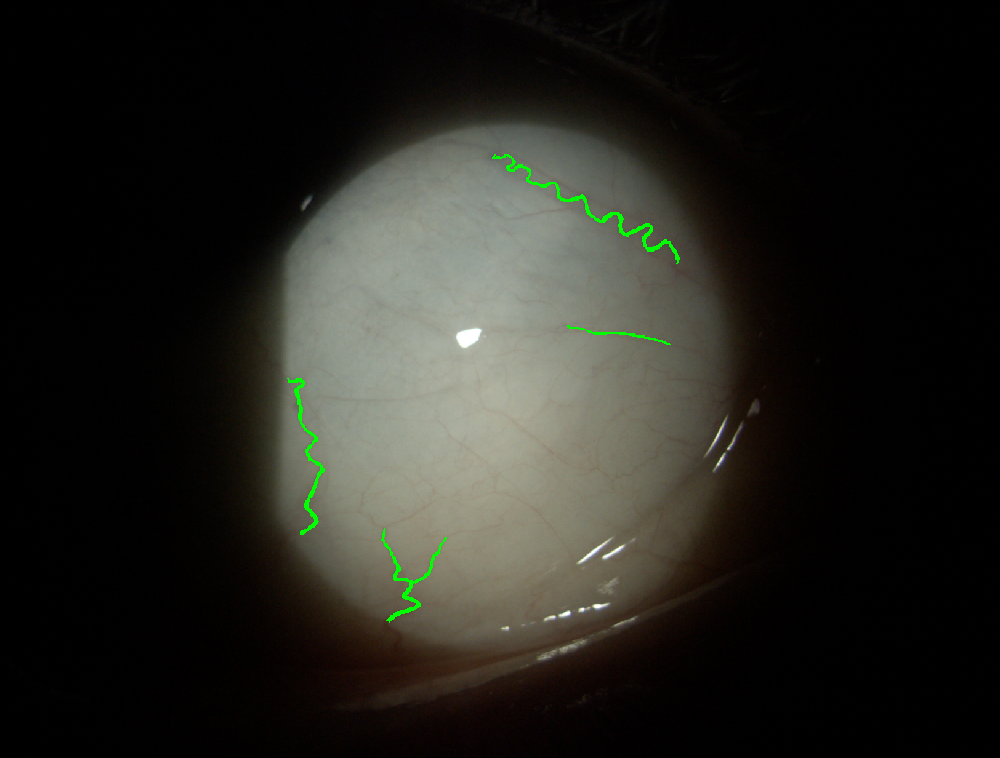

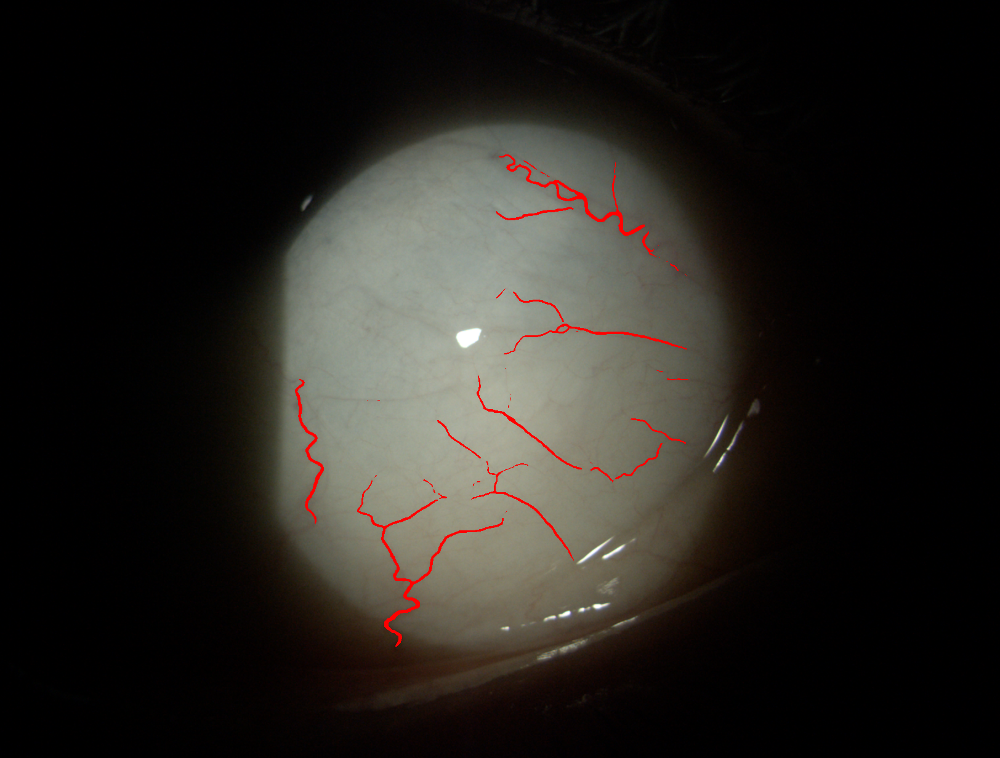

971.png


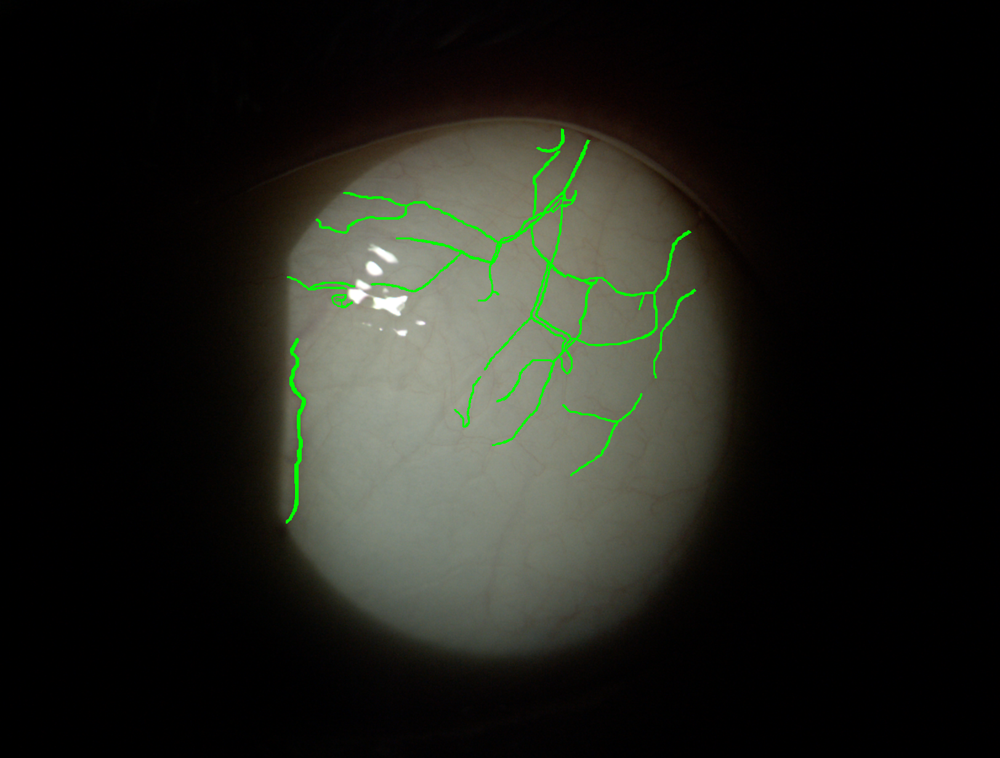

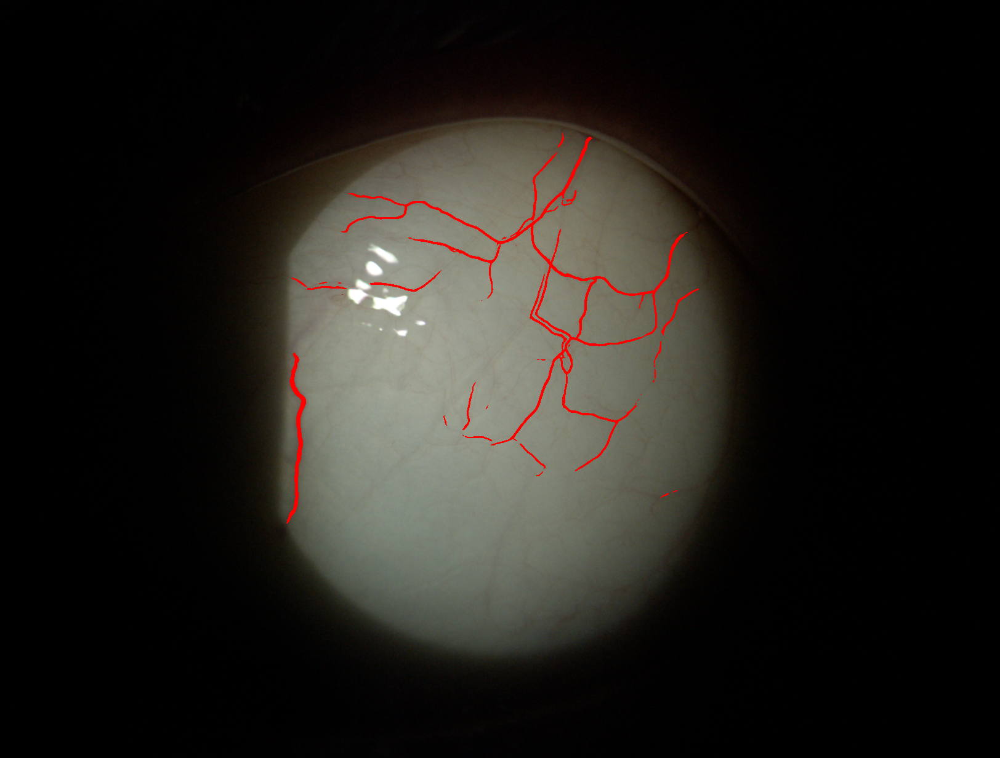

902.png


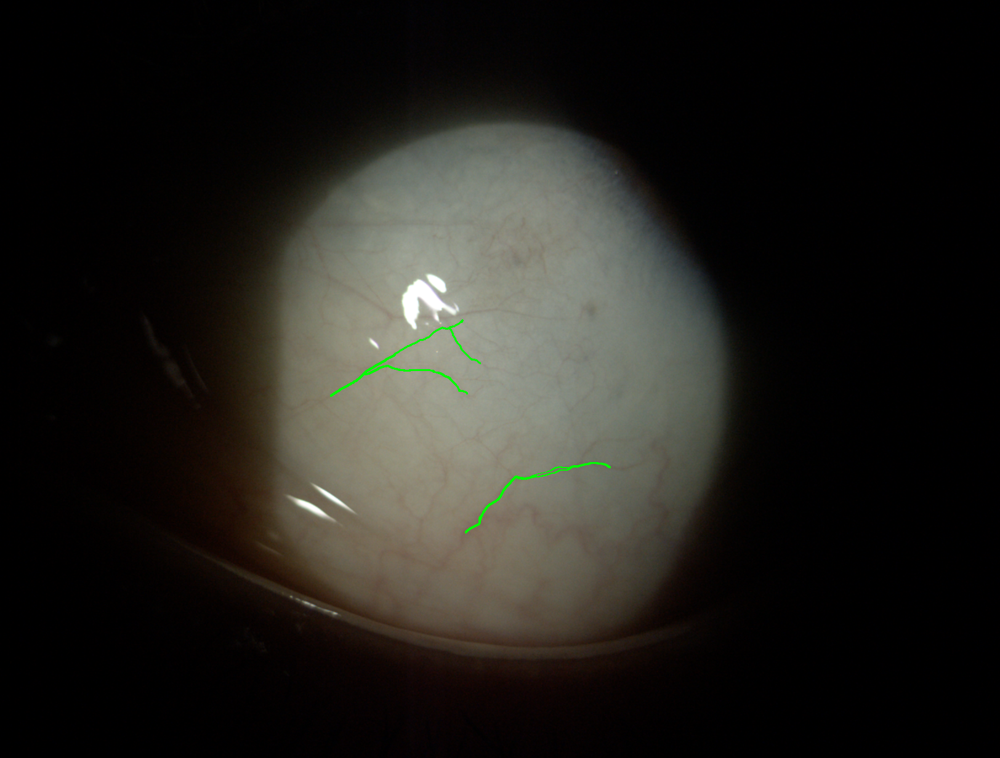

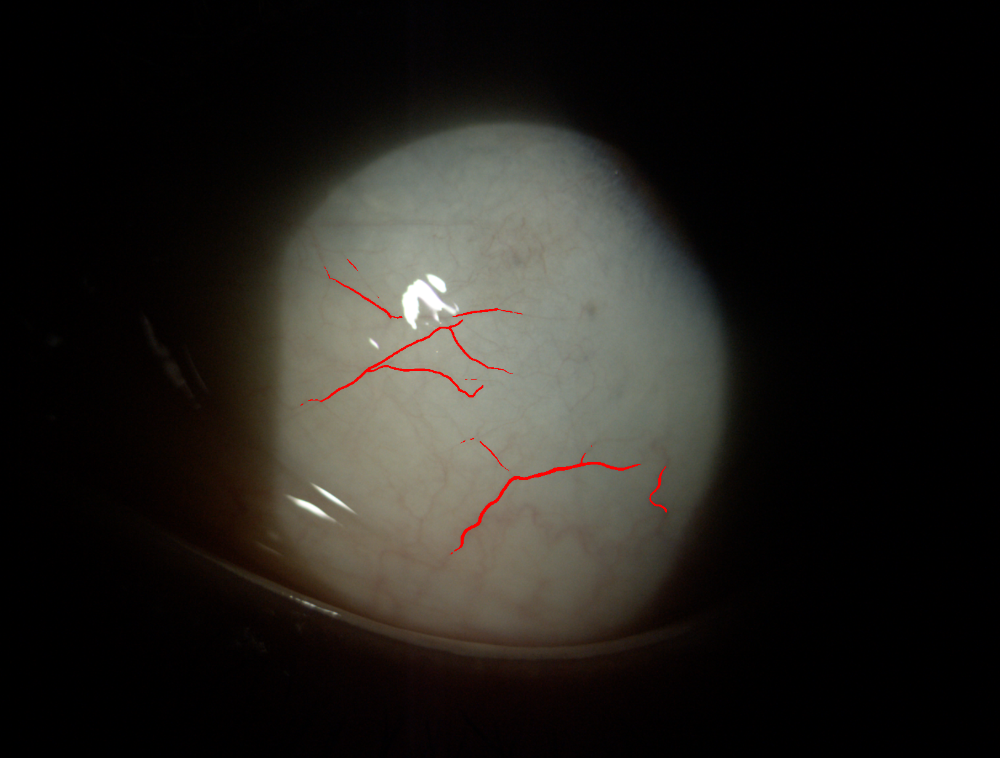

851.png


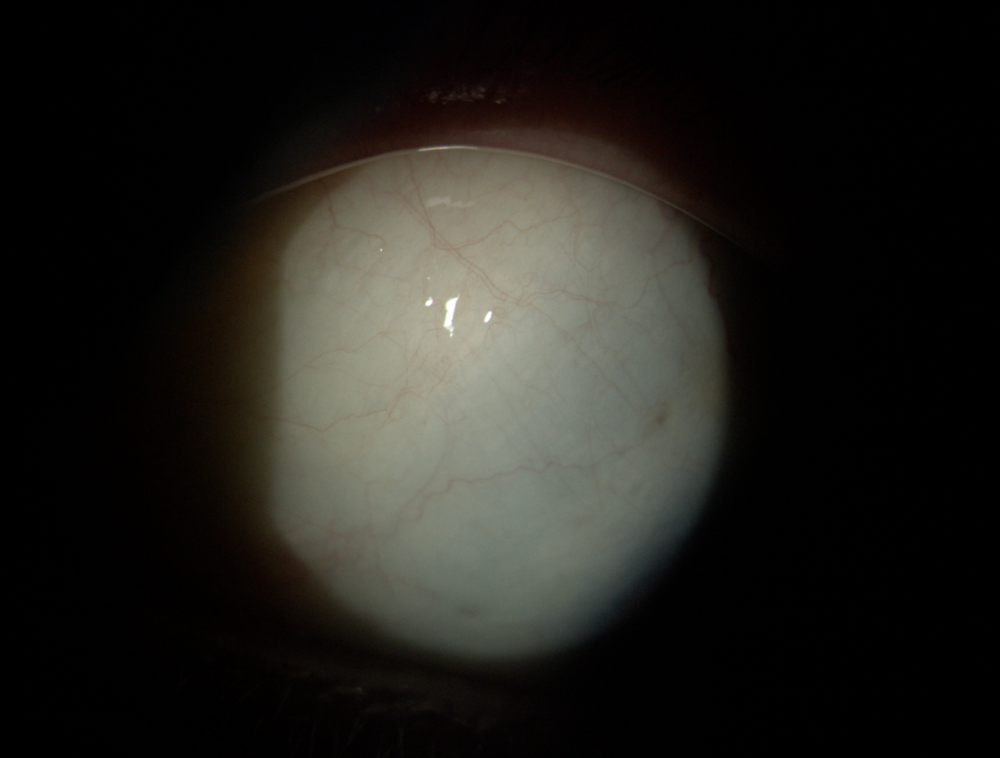

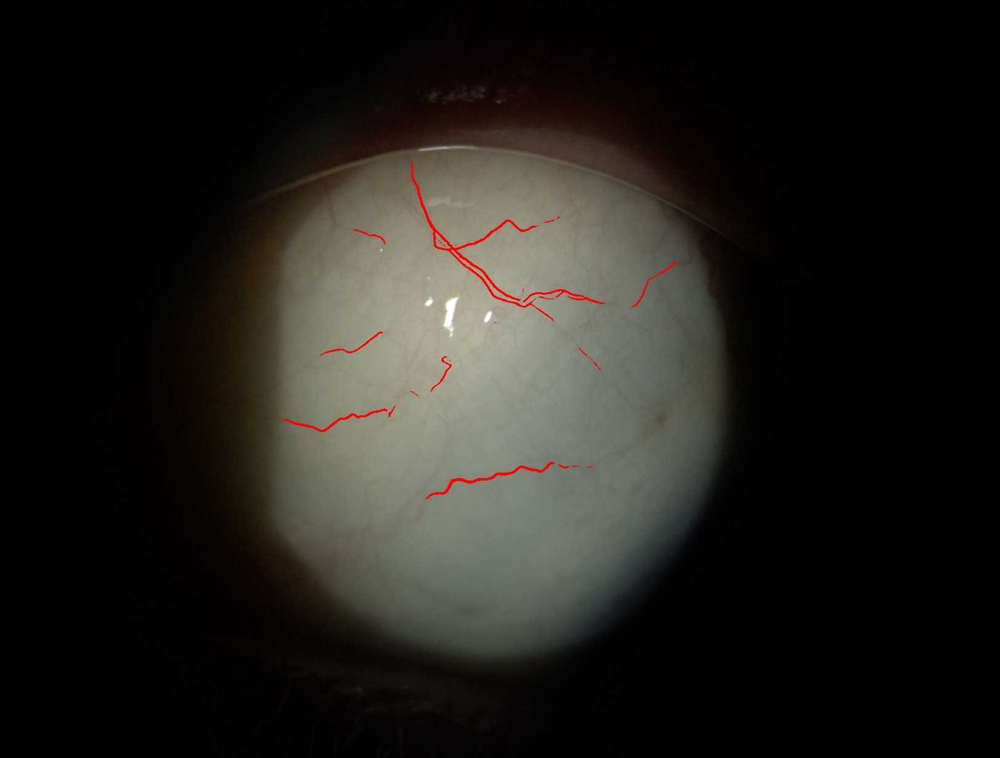

958.png


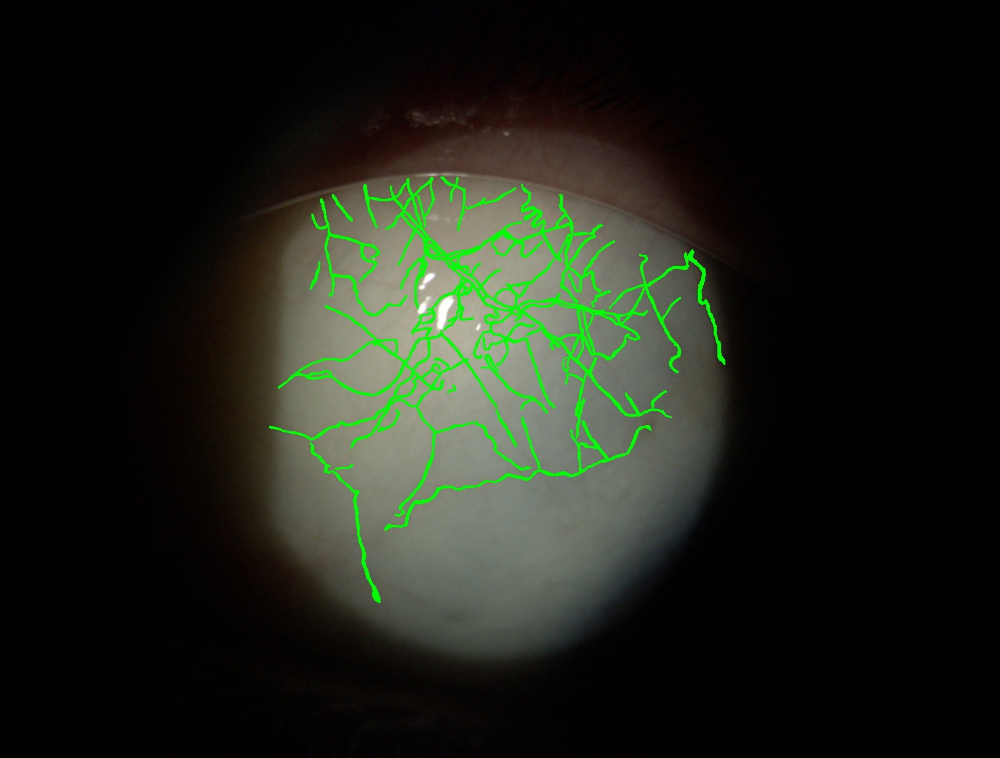

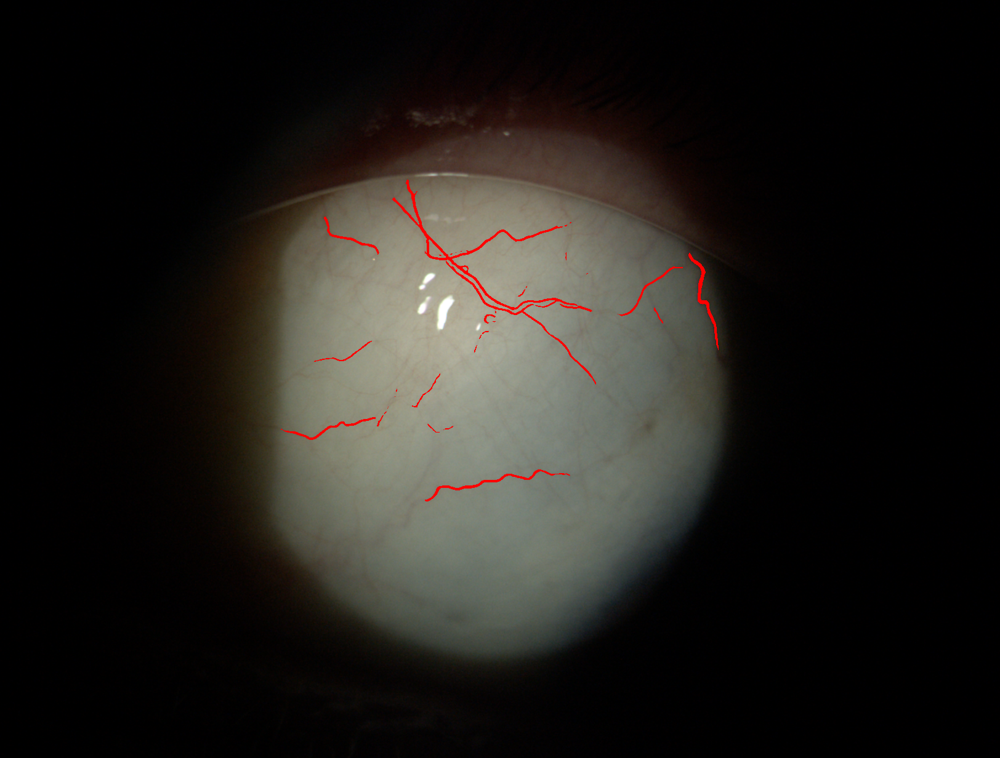

874.png


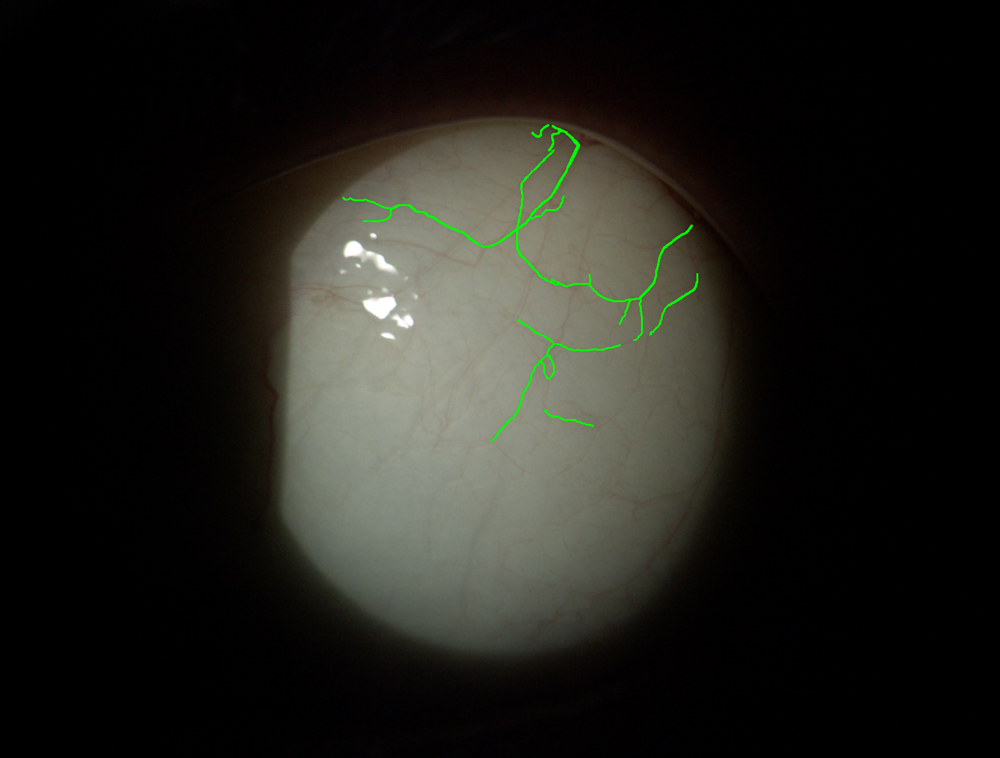

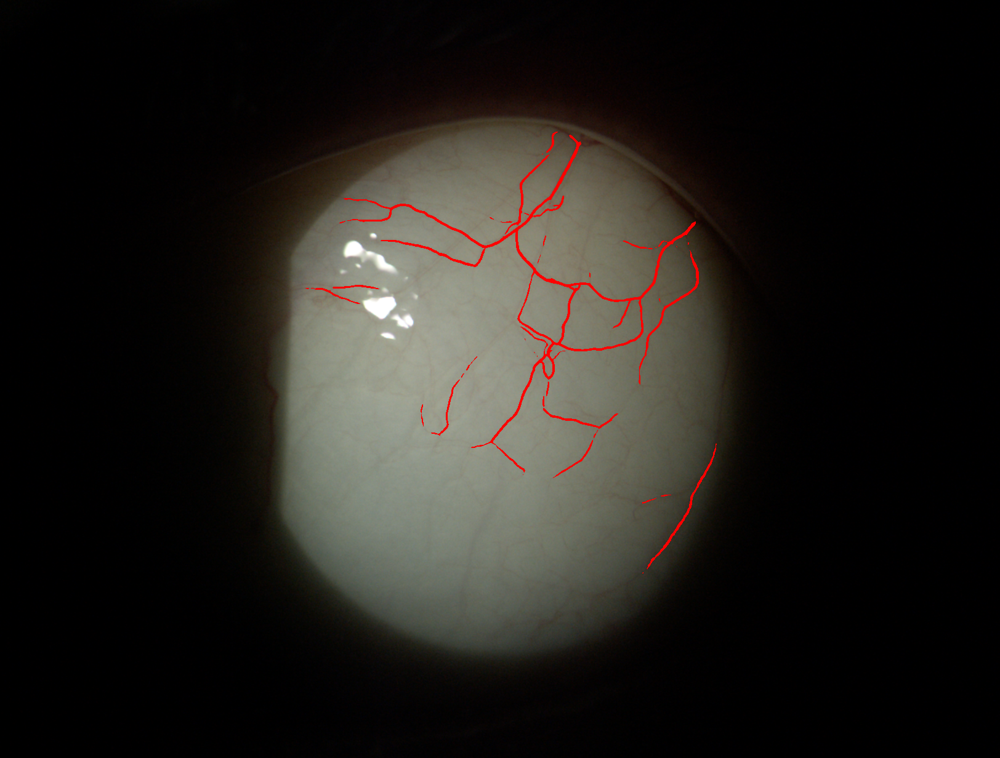

918.png


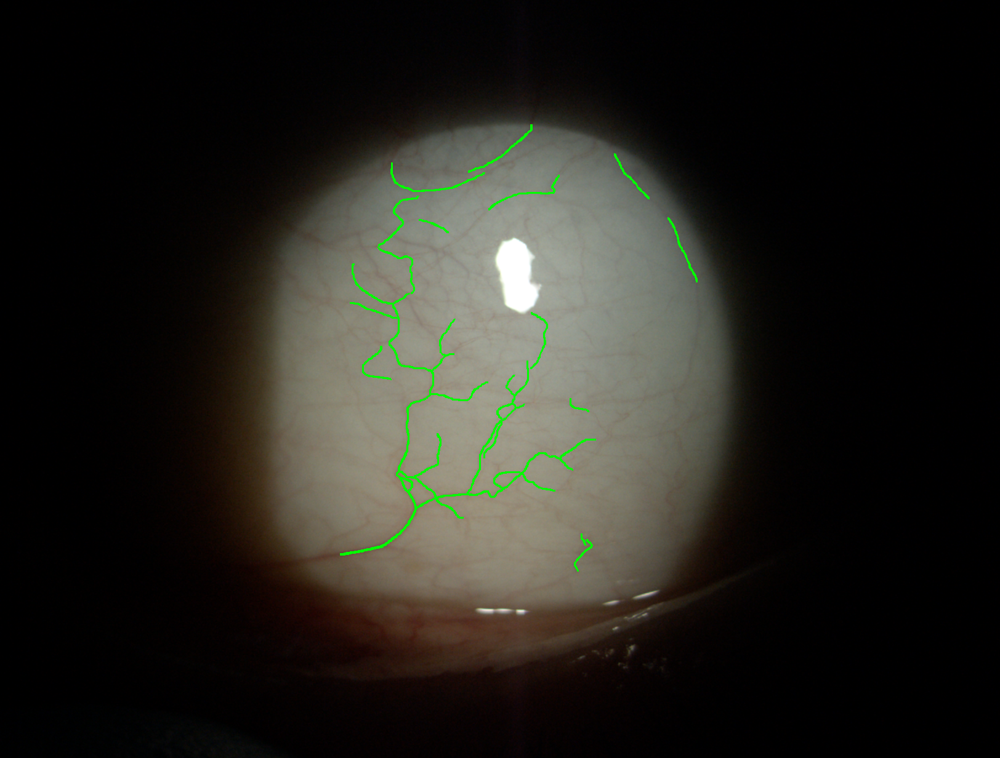

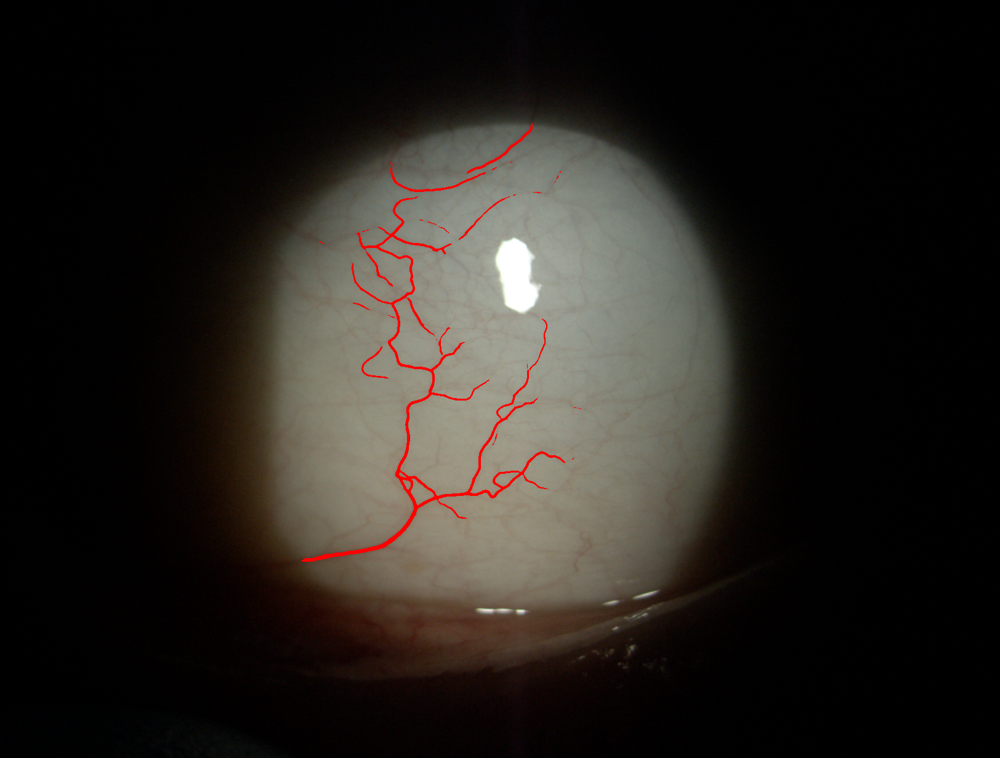

[(None, None, None),
 (None, None, None),
 (None, None, None),
 (None, None, None),
 (None, None, None),
 (None, None, None),
 (None, None, None)]

In [96]:
[(print(Path(train_masks_in_test[i][1]).name), a.show(),b.show()) for i,(a,b) in enumerate(all_overed)]

In [ ]:
'../task/train_dataset/589.png', '../task/test_dataset2/935.png'

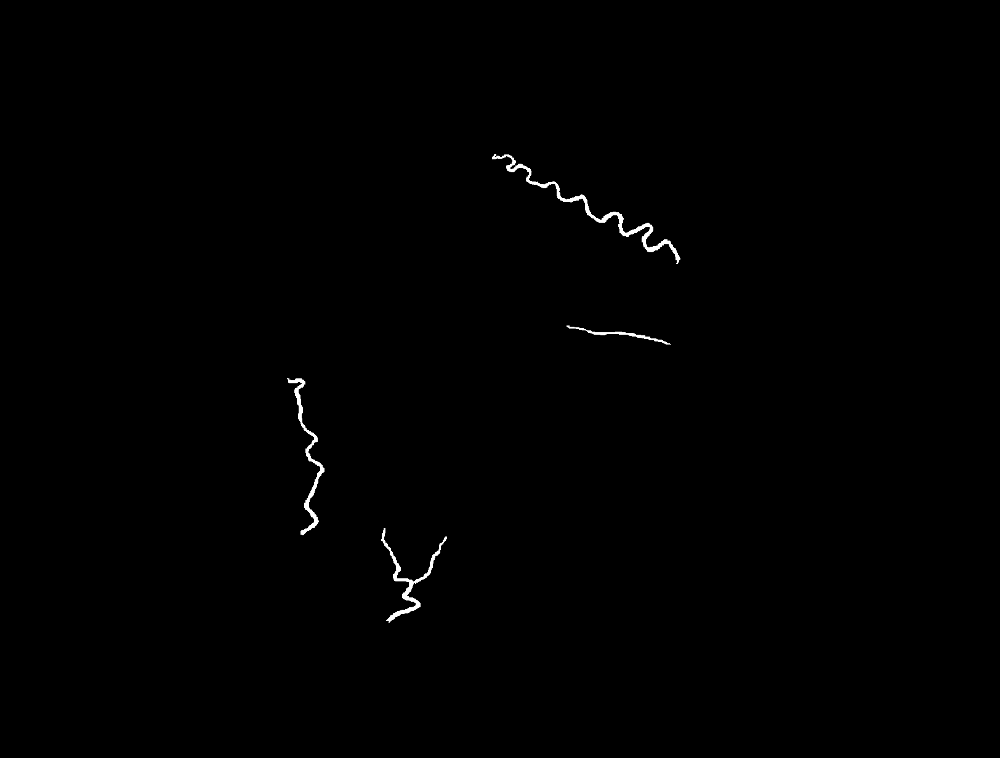

In [72]:
mask = Image.open('../task/train_dataset_masks/589.png')
mask.show()

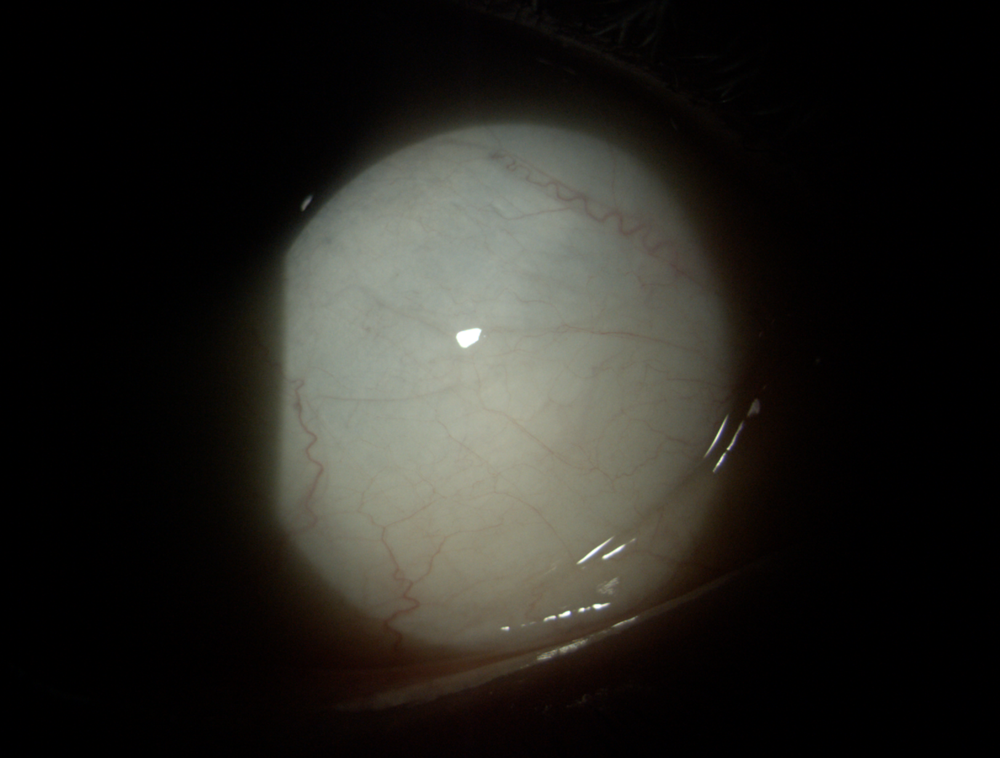

In [70]:
Image.open('../task/test_dataset2/935.png')